# **IDL Assignment 2 - tf.data and Tensorboard**

## **Assigning Tensorflow version and importing the libraries required for the tasks**


In [1]:
%tensorflow_version 2.x

import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import os

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
tf.__version__

'2.2.0-rc3'

## **Initialising file upload and mounting drive**

In [3]:
from google.colab import files
files.upload()

Saving datasets.py to datasets.py


{'datasets.py': b'import numpy as np\n\n\nclass MNISTDataset:\n    """\'Bare minimum\' class to wrap MNIST numpy arrays into a dataset."""\n    def __init__(self, train_imgs, train_lbs, test_imgs, test_lbls, batch_size,\n                 to01=True, shuffle=True, seed=None):\n        """\n        Use seed optionally to always get the same shuffling (-> reproducible\n        results).\n        """\n        self.batch_size = batch_size\n        self.train_data = train_imgs\n        self.train_labels = train_lbs.astype(np.int32)\n        self.test_data = test_imgs\n        self.test_labels = test_lbls.astype(np.int32)\n\n        if to01:\n            # int in [0, 255] -> float in [0, 1]\n            self.train_data = self.train_data.astype(np.float32) / 255\n            self.test_data = self.test_data.astype(np.float32) / 255\n\n        self.size = self.train_data.shape[0]\n\n        if seed:\n            np.random.seed(seed)\n        if shuffle:\n            self.shuffle_train()\n        

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


## **Importing datasets**

In [ ]:
from datasets import MNISTDataset

11493376/11490434 [==============================] - 0s 0us/step


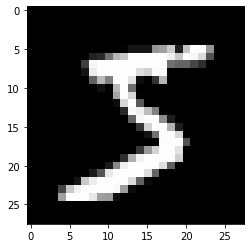

In [ ]:
plt.imshow(train_images[0], cmap="Greys_r")


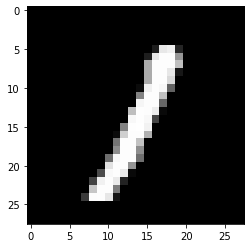

In [ ]:
plt.imshow(train_images[455], cmap="Greys_r")


In [ ]:
print(train_images.shape)
print(test_images.shape)

(60000, 28, 28)
(10000, 28, 28)


In [ ]:
mnist_data = MNISTDataset(train_images.reshape([-1, 784]), train_labels, 
                    test_images.reshape([-1, 784]), test_labels,
                    batch_size=128)

## **Failed Scripts and their explanation**

In [ ]:
# then load/run tensorboard

%load_ext tensorboard

### **Failed Script 1**

**Observations**



1.   Pilot run of the script without any changes yields Loss values of *nan* and therefore analysis on the log files is required to find out the reason for nan. 
2.   The histograms aren't viewable due to the presence of *nan* in the weight vectors. 
3.   Hence the values obtained at the output layer are checked before calculating the loss. It is observed that the values obtained at the output layer is also obtained as *nan* after few steps. This might be attributed to the activation function. These types are attributed to vanishing gradient or exploding gradient problems. Hence changing an activation function is advised. 

4.   Changing the activation function from relu to leakyReLU yielded no gain as the loss obtained was still *nan* and changin to relu6 gave a final **test accuracy** of **11.35%** and the losses were resolved from being *nan*. 
5.   Changing the activation function to other activiations the following test accuracy were recorded.  

    


> *   Sigmoid - 19.94%
*   Tanh    - 93.72% 


**Solution:** Hence an appropriate activation function needs to be chosen to avoid nans. Here change it to tanh






In [ ]:
from datasets import MNISTDataset
from time import time


# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# Defining the log files
# set up log dir and file writer(s)
import datetime
logdir = os.path.join("logs", "Failed Script 1 " + str(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")))
train_writer = tf.summary.create_file_writer(os.path.join(logdir, "train"))
test_writer = tf.summary.create_file_writer(os.path.join(logdir, "test"))

# define the model first, from input to output

# this is a super deep model, cool!
n_units = 100
n_layers = 8
w_range = 0.4

# just set up a "chain" of hidden layers
layers = []
for layer in range(n_layers):
    layers.append(tf.keras.layers.Dense(
        n_units, activation=tf.nn.tanh,
        kernel_initializer=tf.initializers.RandomUniform(minval=-w_range,
                                                         maxval=w_range),
        bias_initializer=tf.initializers.constant(0.001)))

# finally add the output layer
layers.append(tf.keras.layers.Dense(
    10, kernel_initializer=tf.initializers.RandomUniform(minval=-w_range,
                                                         maxval=w_range)))

lr = 0.1
for step in range(2000):
    img_batch, lbl_batch = mnist.next_batch()
    with tf.GradientTape() as tape:
        # here we just run all the layers in sequence via a for-loop
        out = img_batch
        for layer in layers:
            out = layer(out)
        #print(out[0])
        xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
            logits=out, labels=lbl_batch))

    weights = [var for l in layers for var in l.trainable_variables]
    grads = tape.gradient(xent, weights)
    for grad, var in zip(grads, weights):
        var.assign_sub(lr*grad)
            
    
    with train_writer.as_default():
        tf.summary.scalar("loss", xent, step=step)
        tf.summary.histogram("logits", out, step=step)
        tf.summary.histogram("weights layer 1", weights[0], step=step)
    
    if not step % 100:
        preds = tf.argmax(out, axis=1, output_type=tf.int32)
        tracc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
        print("Loss: {} Accuracy: {}".format(xent, tracc))
        
        with train_writer.as_default():
            tf.summary.scalar("Train accuracy", tracc, step=step)
            tf.summary.image("input image", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)
        

out = mnist.test_data
for layer in layers:
    out = layer(out)
test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
tesacc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))


with test_writer.as_default():
    tf.summary.scalar("Test accuracy", tesacc, step=step)


print("Final test accuracy: {}".format(tesacc))


Loss: 3.695624589920044 Accuracy: 0.08984375
Loss: 0.7148920893669128 Accuracy: 0.77734375
Loss: 0.5925440788269043 Accuracy: 0.796875
Starting new epoch...
Loss: 0.4018521010875702 Accuracy: 0.8828125
Loss: 0.22257757186889648 Accuracy: 0.91796875
Starting new epoch...
Loss: 0.2104736864566803 Accuracy: 0.9296875
Loss: 0.28999656438827515 Accuracy: 0.91015625
Loss: 0.24342824518680573 Accuracy: 0.9296875
Starting new epoch...
Loss: 0.11421132832765579 Accuracy: 0.95703125
Loss: 0.1883627474308014 Accuracy: 0.9453125
Starting new epoch...
Loss: 0.13448673486709595 Accuracy: 0.96484375
Loss: 0.20466569066047668 Accuracy: 0.94921875
Starting new epoch...
Loss: 0.10767959803342819 Accuracy: 0.96484375
Loss: 0.09307779371738434 Accuracy: 0.97265625
Loss: 0.11521837115287781 Accuracy: 0.94921875
Starting new epoch...
Loss: 0.10700325667858124 Accuracy: 0.96484375
Loss: 0.0869915783405304 Accuracy: 0.97265625
Starting new epoch...
Loss: 0.09616190195083618 Accuracy: 0.98046875
Loss: 0.119444

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

### **Failed Script 2**

**Observations**


1.   On direct run it was observed that the sigmoid activation fared poorly in this aspect and gave a **test accuracy** of **11.3%**
2.   With visualisations of logits using tensorboard we can say that the range is improper and hence a better activation function is required. 
3.   Changing the activation from Sigmoid to ReLU yielded a **test accuracy** of **92.54%** and the visualizations of the output says the range of logits is balanced.
4.   Changing the activation from Sigmoid to tanh yielded a **test accuracy** of **95.56%** and the visualizations of the output also sas that the range of logits is balanced. 


**Solution** : Change activation function from sigmoid to tanh/ReLU


In [ ]:
from datasets import MNISTDataset
from time import time

# Defining the log files
# set up log dir and file writer(s)
import datetime
logdir = os.path.join("logs", "Failed Script 2 " + str(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")))
train_writer = tf.summary.create_file_writer(os.path.join(logdir, "train"))
test_writer = tf.summary.create_file_writer(os.path.join(logdir, "test"))


# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# define the model first, from input to output

# this is a super deep model, cool!
n_units = 100
n_layers = 8
w_range = 0.1


def model_train():

    # just set up a "chain" of hidden layers
    layers = []
    for layer in range(n_layers):
        layers.append(tf.keras.layers.Dense(
            n_units, activation=tf.nn.relu,
            kernel_initializer=tf.initializers.RandomUniform(minval=-w_range,
                                                            maxval=w_range),
            bias_initializer=tf.initializers.constant(0.001)))

    # finally add the output layer
    layers.append(tf.keras.layers.Dense(
        10, kernel_initializer=tf.initializers.RandomUniform(minval=-w_range,
                                                            maxval=w_range)))

    lr = 0.1
    for step in range(2000):
        img_batch, lbl_batch = mnist.next_batch()
        with tf.GradientTape() as tape:
            # here we just run all the layers in sequence via a for-loop
            out = img_batch
            for layer in layers:
                out = layer(out)
            xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
                logits=out, labels=lbl_batch))

        weights = [var for l in layers for var in l.trainable_variables]
        grads = tape.gradient(xent, weights)
        for grad, var in zip(grads, weights):
            var.assign_sub(lr*grad)


        with train_writer.as_default():
            tf.summary.scalar("loss", xent, step=step)
            tf.summary.histogram("logits", out, step=step)
            tf.summary.histogram("weights layer 1", weights[0], step=step)
            tf.summary.histogram("weights layer output", weights[16], step=step)

        if not step % 100:
            preds = tf.argmax(out, axis=1, output_type=tf.int32)
            tracc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
            print("Loss: {} Accuracy: {}".format(xent, tracc))

            with train_writer.as_default():
                tf.summary.scalar("Train accuracy", tracc, step=step)
                tf.summary.image("input image", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)


    out = mnist.test_data
    for layer in layers:
        out = layer(out)
    test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
    tesacc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))

    with test_writer.as_default():
        tf.summary.scalar("Test accuracy", tesacc, step=step)


    print("Final test accuracy: {}".format(tesacc))


In [6]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [13]:
model_train()

Loss: 2.3025474548339844 Accuracy: 0.1015625
Loss: 2.2996222972869873 Accuracy: 0.15234375
Loss: 2.2939469814300537 Accuracy: 0.1796875
Starting new epoch...
Loss: 2.300452709197998 Accuracy: 0.09765625
Loss: 2.3033719062805176 Accuracy: 0.10546875
Starting new epoch...
Loss: 2.2924885749816895 Accuracy: 0.15625
Loss: 2.298825979232788 Accuracy: 0.109375
Loss: 2.301833391189575 Accuracy: 0.0859375
Starting new epoch...
Loss: 2.2968859672546387 Accuracy: 0.08984375
Loss: 2.2786083221435547 Accuracy: 0.10546875
Starting new epoch...
Loss: 1.9971742630004883 Accuracy: 0.171875
Loss: 1.6074697971343994 Accuracy: 0.33203125
Starting new epoch...
Loss: 1.1256954669952393 Accuracy: 0.50390625
Loss: 0.9989738464355469 Accuracy: 0.61328125
Loss: 0.7317559123039246 Accuracy: 0.6875
Starting new epoch...
Loss: 0.5712820887565613 Accuracy: 0.8515625
Loss: 0.573661208152771 Accuracy: 0.84375
Starting new epoch...
Loss: 0.6339057683944702 Accuracy: 0.80078125
Loss: 0.3204294443130493 Accuracy: 0.921

### **Failed Script 3**

**Observations**


1.   A first run of the program gives us a **Test accuracy** of **11.35%**
2.   On observations through distribution of weights and through histograms, it was observed that the weights are in the range of -0.01 and 0 which is very very bad for initialisation. 
3.   **Solution:** On re-initialising weights between -0.01 and 0.01, the Training accuracy was improved to **92.96%**



In [ ]:

from datasets import MNISTDataset
from time import time

# Defining the log files
# set up log dir and file writer(s)
import datetime
logdir = os.path.join("logs", "Failed Script 3 " + str(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")))
train_writer = tf.summary.create_file_writer(os.path.join(logdir, "train"))
test_writer = tf.summary.create_file_writer(os.path.join(logdir, "test"))


# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# define the model first, from input to output

# let's use fewer layers...
n_units = 100
n_layers = 2


def model_train_script3():
    # just set up a "chain" of hidden layers
    layers = []
    for layer in range(n_layers):
        layers.append(tf.keras.layers.Dense(
            n_units, activation=tf.nn.relu,
            kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                            maxval=0.01),
            bias_initializer=tf.initializers.constant(0.001)))

    # finally add the output layer
    layers.append(tf.keras.layers.Dense(
        10, kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                            maxval=0.01)))

    lr = 0.1
    for step in range(2000):
        img_batch, lbl_batch = mnist.next_batch()
        with tf.GradientTape() as tape:
            # here we just run all the layers in sequence via a for-loop
            out = img_batch
            for layer in layers:
                out = layer(out)
            xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
                logits=out, labels=lbl_batch))

        weights = [var for l in layers for var in l.trainable_variables]
        grads = tape.gradient(xent, weights)
        for grad, var in zip(grads, weights):
            var.assign_sub(lr*grad)


        with train_writer.as_default():
            tf.summary.scalar("loss", xent, step=step)
            tf.summary.histogram("logits", out, step=step)
            tf.summary.histogram("weights layer 1", weights[0], step=step)
            tf.summary.histogram("weights layer 2", weights[2], step=step)
            tf.summary.histogram("weights layer 3", weights[4], step=step)


        if not step % 100:
            preds = tf.argmax(out, axis=1, output_type=tf.int32)
            tracc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
            print("Loss: {} Accuracy: {}".format(xent, tracc))

            with train_writer.as_default():
                tf.summary.scalar("Train accuracy", tracc, step=step)
                tf.summary.image("input image", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)


    out = mnist.test_data
    for layer in layers:
        out = layer(out)
    test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
    tesacc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))


    with test_writer.as_default():
        tf.summary.scalar("Test accuracy", tesacc, step=step)


    print("Final test accuracy: {}".format(acc))


In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
model_train_script3()

Loss: 2.3025898933410645 Accuracy: 0.10546875
Loss: 2.3000612258911133 Accuracy: 0.1171875
Loss: 2.3061585426330566 Accuracy: 0.07421875
Starting new epoch...
Loss: 2.3005409240722656 Accuracy: 0.10546875
Loss: 2.3003833293914795 Accuracy: 0.1171875
Starting new epoch...
Loss: 2.2835726737976074 Accuracy: 0.16796875
Loss: 1.8054249286651611 Accuracy: 0.32421875
Loss: 0.9763220548629761 Accuracy: 0.71484375
Starting new epoch...
Loss: 0.5764575004577637 Accuracy: 0.78125
Loss: 0.5582663416862488 Accuracy: 0.82421875
Starting new epoch...
Loss: 0.5520927906036377 Accuracy: 0.84765625
Loss: 0.539233922958374 Accuracy: 0.83203125
Starting new epoch...
Loss: 0.4434353709220886 Accuracy: 0.85546875
Loss: 0.418049693107605 Accuracy: 0.8828125
Loss: 0.3343685269355774 Accuracy: 0.8984375
Starting new epoch...
Loss: 0.33926790952682495 Accuracy: 0.91015625
Loss: 0.26552003622055054 Accuracy: 0.921875
Starting new epoch...
Loss: 0.30137544870376587 Accuracy: 0.921875
Loss: 0.27277201414108276 Ac

### **Failed Script 4**

**Observations**


1.   On a pilot run, we observe that the **Test Accuracy** obtained was **78.61%**. On reading through the code we analyze that the data which is being trained is added with *random noise* so as to help generalization. The noise added is with a Standard deviation of 4. But we also observe that the model gerneralizes well even though it has poor training accuracy. This is attributed to the fact that the noise wasn't added to the data which was used in testing. 
2.   When visualizing the images on Tensorboard, the numbers are almost viewied similar to QR code. It has heavy noise attributed to it. 
3.   Hence we try reducing the Std. Dev. We see that on reducing it there is a considerable increase in the Training accuracy thus the model getting better. 
4.   As Std. Dev is reduced we see that the images passed into the network are identifiable and therby we get a better training accuracy. 
5.   For a Std. Dev of 0.1, **Test Accuracy** obtained was **92.77%**.
6.   For a Std. Dev of 0.05, **Test Accuracy** obtained was **92.7%**.
7.   After removing Std. Dev, **Test Accuracy** obtained was **92.61%**.


**Solution:** Bring down the Std. Dev value to preferably 0.05



In [ ]:
from datasets import MNISTDataset
from time import time


# Defining the log files
# set up log dir and file writer(s)
import datetime
logdir = os.path.join("logs", "Failed Script 4 " + str(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")))
train_writer = tf.summary.create_file_writer(os.path.join(logdir, "train"))
test_writer = tf.summary.create_file_writer(os.path.join(logdir, "test"))


# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# define the model first, from input to output

# let's use fewer layers...
n_units = 100
n_layers = 2


def model_train_script4():
      
    # just set up a "chain" of hidden layers
    layers = []
    for layer in range(n_layers):
        layers.append(tf.keras.layers.Dense(
            n_units, activation=tf.nn.relu,
            kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                            maxval=0.01),
            bias_initializer=tf.initializers.constant(0.001)))

    # finally add the output layer
    layers.append(tf.keras.layers.Dense(
        10, kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                            maxval=0.01)))

    lr = 0.1
    for step in range(2000):
        img_batch, lbl_batch = mnist.next_batch()
        # I hear adding random noise to inputs helps with generalization!
        img_batch = img_batch + tf.random.normal(tf.shape(img_batch), stddev=4)
        with tf.GradientTape() as tape:
            # here we just run all the layers in sequence via a for-loop
            out = img_batch
            for layer in layers:
                out = layer(out)
            xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
                logits=out, labels=lbl_batch))

        weights = [var for l in layers for var in l.trainable_variables]
        grads = tape.gradient(xent, weights)
        for grad, var in zip(grads, weights):
            var.assign_sub(lr*grad)

        with train_writer.as_default():
            tf.summary.scalar("loss", xent, step=step)
            tf.summary.histogram("logits", out, step=step)
            tf.summary.histogram("weights layer 1", weights[0], step=step)
            tf.summary.histogram("weights layer 2", weights[2], step=step)
            tf.summary.histogram("weights layer output", weights[4], step=step)

        if not step % 100:
            preds = tf.argmax(out, axis=1, output_type=tf.int32)
            tracc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
            print("Loss: {} Accuracy: {}".format(xent, tracc))


            with train_writer.as_default():
                tf.summary.scalar("Train accuracy", tracc, step=step)
                tf.summary.image("input image", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)

    out = mnist.test_data
    for layer in layers:
        out = layer(out)
    test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
    tesacc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))
    print("Final test accuracy: {}".format(tesacc))


    with test_writer.as_default():
        tf.summary.scalar("Test accuracy", tesacc, step=step)


In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
model_train_script4()

Loss: 2.3025898933410645 Accuracy: 0.1328125
Loss: 2.299391746520996 Accuracy: 0.1328125
Loss: 2.295527935028076 Accuracy: 0.14453125
Starting new epoch...
Loss: 2.3010811805725098 Accuracy: 0.09765625
Loss: 2.298243522644043 Accuracy: 0.09765625
Starting new epoch...
Loss: 2.1230075359344482 Accuracy: 0.22265625
Loss: 1.4035286903381348 Accuracy: 0.5234375
Loss: 0.8027182221412659 Accuracy: 0.69921875
Starting new epoch...
Loss: 0.6061822772026062 Accuracy: 0.796875
Loss: 0.6056017875671387 Accuracy: 0.82421875
Starting new epoch...
Loss: 0.5198425650596619 Accuracy: 0.84765625
Loss: 0.5031718611717224 Accuracy: 0.87109375
Starting new epoch...
Loss: 0.4412958025932312 Accuracy: 0.875
Loss: 0.3309403359889984 Accuracy: 0.90234375
Loss: 0.3074215054512024 Accuracy: 0.921875
Starting new epoch...
Loss: 0.4237563908100128 Accuracy: 0.86328125
Loss: 0.364799439907074 Accuracy: 0.90234375
Starting new epoch...
Loss: 0.35402095317840576 Accuracy: 0.90625
Loss: 0.21002346277236938 Accuracy: 

### **Failed Script 5**

**Observations**


1.   On a pilot run, we observe that the **Test Accuracy** obtained was **11.35%**. 
2.   We see that a softmax activation is used at the output layer. Hence we see the values observed at the output layer through Tensorboard visualizations. We see a value of 1 always. Hence this sounds fuzzy. This is attributed to softmax at output layer. 
3.   Adding ReLU as output layer activation gave us poor results than that of Softmax. 
4.   After removing the activation function from the output layer, we observe that the **Test Accuracy** obtained was **93.08%**.

In [ ]:

from datasets import MNISTDataset
from time import time

# Defining the log files
# set up log dir and file writer(s)
import datetime
logdir = os.path.join("logs", "Failed Script 5 " + str(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")))
train_writer = tf.summary.create_file_writer(os.path.join(logdir, "train"))
test_writer = tf.summary.create_file_writer(os.path.join(logdir, "test"))



# get the data
(train_imgs, train_lbls), (test_imgs, test_lbls) = tf.keras.datasets.mnist.load_data()
mnist = MNISTDataset(train_imgs.reshape((-1, 784)), train_lbls,
                     test_imgs.reshape((-1, 784)), test_lbls,
                     batch_size=256, seed=int(time()))


# define the model first, from input to output

# let's use fewer layers...
n_units = 100
n_layers = 2


def model_train_script5():
      
    # just set up a "chain" of hidden layers
    layers = []
    for layer in range(n_layers):
        layers.append(tf.keras.layers.Dense(
            n_units, activation=tf.nn.relu,
            kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                            maxval=0.01),
            bias_initializer=tf.initializers.constant(0.001)))

    # finally add the softmax output layer :))
    layers.append(tf.keras.layers.Dense(
        10, 
        kernel_initializer=tf.initializers.RandomUniform(minval=-0.01,
                                                        maxval=0.01)))

    lr = 0.1
    for step in range(2000):
        img_batch, lbl_batch = mnist.next_batch()
        with tf.GradientTape() as tape:
            # here we just run all the layers in sequence via a for-loop
            out = img_batch
            for layer in layers:
                out = layer(out)
            #print(tf.argmax(out, axis=1, output_type=tf.int32))
            xent = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
                logits=out, labels=lbl_batch))

        weights = [var for l in layers for var in l.trainable_variables]
        grads = tape.gradient(xent, weights)
        for grad, var in zip(grads, weights):
            var.assign_sub(lr*grad)

        with train_writer.as_default():
            tf.summary.scalar("loss", xent, step=step)
            tf.summary.histogram("logits", out, step=step)
            tf.summary.histogram("weights layer 1", weights[0], step=step)
            tf.summary.histogram("weights layer 2", weights[2], step=step)
            tf.summary.histogram("weights layer output", weights[4], step=step)


        if not step % 100:
            preds = tf.argmax(out, axis=1, output_type=tf.int32)
            tracc = tf.reduce_mean(tf.cast(tf.equal(preds, lbl_batch), tf.float32))
            print("Loss: {} Accuracy: {}".format(xent, tracc))

            with train_writer.as_default():
                tf.summary.scalar("Train accuracy", tracc, step=step)
                tf.summary.image("input image", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)


    out = mnist.test_data
    for layer in layers:
        out = layer(out)
    test_preds = tf.argmax(out, axis=1, output_type=tf.int32)
    tesacc = tf.reduce_mean(tf.cast(tf.equal(test_preds, mnist.test_labels), tf.float32))
    print("Final test accuracy: {}".format(tesacc))


    with test_writer.as_default():
        tf.summary.scalar("Test accuracy", tesacc, step=step)


In [ ]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 408), started 1:00:02 ago. (Use '!kill 408' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
model_train_script5()

Loss: 2.3025693893432617 Accuracy: 0.1484375
Loss: 2.304483413696289 Accuracy: 0.08984375
Loss: 2.298844575881958 Accuracy: 0.11328125
Starting new epoch...
Loss: 2.2955503463745117 Accuracy: 0.15625
Loss: 2.297205686569214 Accuracy: 0.10546875
Starting new epoch...
Loss: 2.1420717239379883 Accuracy: 0.1640625
Loss: 1.1745797395706177 Accuracy: 0.6171875
Loss: 0.6922620534896851 Accuracy: 0.78125
Starting new epoch...
Loss: 0.5849270820617676 Accuracy: 0.81640625
Loss: 0.556069016456604 Accuracy: 0.83984375
Starting new epoch...
Loss: 0.49698784947395325 Accuracy: 0.8515625
Loss: 0.50218665599823 Accuracy: 0.84765625
Starting new epoch...
Loss: 0.425869345664978 Accuracy: 0.87890625
Loss: 0.4386734664440155 Accuracy: 0.89453125
Loss: 0.33847349882125854 Accuracy: 0.9140625
Starting new epoch...
Loss: 0.34122776985168457 Accuracy: 0.91015625
Loss: 0.3049854040145874 Accuracy: 0.921875
Starting new epoch...
Loss: 0.3847348093986511 Accuracy: 0.8984375
Loss: 0.26305606961250305 Accuracy: 

## **Using tf.data**

**Note on Shuffle, Batch and Repeat**

1. **Shuffle** - This method randomly shuffles the elements in the dataset. It depends on the buffer size which is one of the parameters when callilng this method. Post the selection of elements in buffer, it then fills in the buffer with next set of elements from the dataset. 
2. **Batch** - The size of consecutive elements to be considered for operation in a single run . 
3. **Repeat** - This process repeats the dataset based on the value passed. Eg. repeat is passed with value 4, the entire dataset is repeated 4 times. 
4. **Shuffle and Batch** - This process divides the dataset into the size of batch mentioned and then shuffles the set of batches.
5. **Shuffle and Repeat** - This process repeats the elements based on repeat value and shuffles the entire set based on shuffle count. 
6. **Batch and Repeat** - This process repeats the dataset based on repeat count and then partitions it into batches of the batch size. 
7. **Shuffle, Batch and Repeat** - This process has data repeated based on the repeat times and then partitions into batches of mentioned size. Then it shuffles the batches and then returns the data. 

**Suggestion** - It can be suggested that the process of Shuffle, Batch and Repeat is preferred over the other methods available. 

**Observations**

1. On running Shuffle, Batch and Repeat we get **Test Accuracy** of **94.89%**
2. On running Shuffle, Repeat and Batch we get **Test Accuracy** of **94.7%**
3. On running Batch, Shuffle and Repeat we get **Test Accuracy** of **94.74%**
4. On running Batch, Repeat and Shuffle we get **Test Accuracy** of **94.9%**
5. On running Repeat, Shuffle and Batch we get **Test Accuracy** of **94.76%**
6. On running Repeat, Batch and Shuffle we get **Test Accuracy** of **94.79%**




In [ ]:
mnist = tf.keras.datasets.mnist
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()


# this is now different
train_data = tf.data.Dataset.from_tensor_slices((train_images, train_labels))



# things we really gotta do:
# - normalize the images to [0, 1] (first convert to float)
# - reshape images from (28, 28) to (784,) (although we could do this later!)
# - convert labels to int32 (otherwise tensorflow is gonna be sad :( )

train_images = (train_images.astype(np.float32) / 255.).reshape((-1, 784))
test_images = (test_images.astype(np.float32) / 255.).reshape((-1, 784))

train_labels = train_labels.astype(np.int32)
test_labels = test_labels.astype(np.int32)

train_data = tf.data.Dataset.from_tensor_slices((train_images, train_labels))


    


In [ ]:
## Declare the sizes of batch, shuffle and repeat

SHUFFLE_SIZE = 10000
BATCH_SIZE = 128
REPEAT_TIMES = 4

In [ ]:
def batch_shuffle_repeat(data):


    data = data.shuffle(SHUFFLE_SIZE, reshuffle_each_iteration= True)
    data = data.repeat(REPEAT_TIMES)
    data = data.batch(BATCH_SIZE)    
    

    return data

In [ ]:
train_data

<TensorSliceDataset shapes: ((784,), ()), types: (tf.float32, tf.int32)>

In [ ]:
## Define Hyper parameters
input_neurons = 784
hidden1_neurons = 112
hidden2_neurons = 64
output_neurons = 10
learning_rate = 0.1

In [ ]:
## Initialising initial weights and biases

# hidden layer1
w1 = tf.Variable(tf.random.uniform([input_neurons,hidden1_neurons], minval=-0.1, maxval=0.1, dtype=tf.dtypes.float32))
b1 = tf.Variable(tf.zeros([hidden1_neurons]))


# hidden layer2
w2 = tf.Variable(tf.random.uniform([hidden1_neurons,hidden2_neurons], minval=-0.1, maxval=0.1, dtype=tf.dtypes.float32))
b2 = tf.Variable(tf.zeros([hidden2_neurons]))


# output layer
w3 = tf.Variable(tf.random.uniform([hidden2_neurons,output_neurons], minval=-0.1, maxval=0.1, dtype=tf.dtypes.float32))
b3 = tf.Variable(tf.zeros([output_neurons]))

# set up log dir and file writer(s)
import datetime
logdir = os.path.join("logs", "MLP MNIST v1 " + str(datetime.datetime.now().strftime("%Y%m%d-%H%M%S")))
train_writer = tf.summary.create_file_writer(os.path.join(logdir, "train"))
test_writer = tf.summary.create_file_writer(os.path.join(logdir, "test"))


In [ ]:

train_data = batch_shuffle_repeat(train_data)
#for step in range(train_steps):
steps = 0
for img_batch,lbl_batch in train_data:
    steps = steps+1
    #img_batch, lbl_batch = mnist_data.next_batch()
    with tf.GradientTape(persistent=True) as tape:

        # The piece of code does the output of the hidden layers and output layer with its corresponding activation function
        h1 = tf.nn.relu(tf.matmul(img_batch, w1) + b1)
        h2 = tf.nn.relu(tf.matmul(h1, w2) + b2)
        logits= tf.matmul(h2, w3) + b3


        # The piece of code calculates the loss obtained at the output layer
        loss_output = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
    logits=logits, labels=lbl_batch))
        

        
    ## Gradient functionality is done using "tape"    
    grads = tape.gradient(loss_output, [w1, b1, w2, b2, w3, b3])

    w1.assign_sub(learning_rate * grads[0])
    b1.assign_sub(learning_rate * grads[1])

    w2.assign_sub(learning_rate * grads[2])
    b2.assign_sub(learning_rate * grads[3])

    w3.assign_sub(learning_rate * grads[4])
    b3.assign_sub(learning_rate * grads[5])


    ## Logging the losses, logits and weights
    with train_writer.as_default():
        tf.summary.scalar("loss", loss_output, step=step)
        tf.summary.histogram("logits", logits, step=step)
        tf.summary.histogram("weights at input to H1 layer", w1, step=step)
        tf.summary.histogram("weights at H1 to H2 layer", w2, step=step)
        tf.summary.histogram("weights at H2 to output layer", w3, step=step)
    
    # Print the accuracy and losses after every 100 iteration
    if not steps % 100:
        train_preds = tf.argmax(logits, axis=1, output_type=tf.int32)
        train_acc = tf.reduce_mean(tf.cast(tf.equal(train_preds, lbl_batch),
                             tf.float32))
        print("Loss: {} Accuracy: {}".format(loss_output, train_acc))

        ## Logging the accuracy of train data
        with train_writer.as_default():
            tf.summary.scalar("Train accuracy", train_acc, step=step)
            tf.summary.image("input", tf.reshape(img_batch, [-1, 28, 28, 1]), step=step)


Loss: 0.8010760545730591 Accuracy: 0.796875
Loss: 0.39460861682891846 Accuracy: 0.890625
Loss: 0.41253429651260376 Accuracy: 0.8828125
Loss: 0.5154930949211121 Accuracy: 0.8515625
Loss: 0.14734026789665222 Accuracy: 0.96875
Loss: 0.21504689753055573 Accuracy: 0.9296875
Loss: 0.28575995564460754 Accuracy: 0.90625
Loss: 0.3145175576210022 Accuracy: 0.8671875
Loss: 0.22630053758621216 Accuracy: 0.9296875
Loss: 0.1456645280122757 Accuracy: 0.9453125
Loss: 0.2014690339565277 Accuracy: 0.953125
Loss: 0.12504136562347412 Accuracy: 0.9609375
Loss: 0.15756751596927643 Accuracy: 0.953125
Loss: 0.16766130924224854 Accuracy: 0.9296875
Loss: 0.1101732850074768 Accuracy: 0.953125
Loss: 0.17943182587623596 Accuracy: 0.9453125
Loss: 0.13025540113449097 Accuracy: 0.9609375
Loss: 0.2144213169813156 Accuracy: 0.9609375


In [ ]:
test_pred_h1 = tf.nn.relu(tf.matmul(test_images, w1) + b1)  
test_pred_h2 = tf.nn.relu(tf.matmul(test_pred_h1, w2) + b2) 
test_preds = tf.argmax(tf.matmul(test_pred_h2, w3) + b3, axis=1,
                       output_type=tf.int32)
test_acc = tf.reduce_mean(tf.cast(tf.equal(test_preds, test_labels),
                             tf.float64))

print("Accuracy: {}".format(test_acc))

## Logging the test accuracy in the test logs
with test_writer.as_default():
    tf.summary.scalar("Test accuracy", test_acc, step=step)

Accuracy: 0.9575


#### **Tensorboard visualisation**

In [ ]:
# then load/run tensorboard

%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 408), started 6:27:02 ago. (Use '!kill 408' to kill it.)

<IPython.core.display.Javascript object>